# Proyecto Open Data I
## Radares, y su eficiencia en la CAM
### Análisis descriptivo y exploratorio de los datos
Este cuaderno pretende enseñar el proceso de análisis los datos relativos a los radares en la CAM
_Paula Gómez Lucas, Alejandro Majado Martínez_

### Análisis Descriptivo de los Datos
A continuación, veremos, dataframe a dataframe, el análisis descriptivo


In [74]:
for i in data.keys():
    print(i)

datasets/actuacionesBomberos
datasets/estaciones
datasets/accidentalidad
calendario.csv
DireccionesEvolucionHistorica_20231004.csv
DireccionesVigentes_20231004.csv
iluminacion.csv
padron22.csv
RADARES_FIJOS_vDTT.csv
VialesEvolucionHistorica_20231004.csv
VialesVigentesDistritosBarrios_20231004.csv
VialesVigentesDistritos_20231004.csv
VialesVigentes_20231004.csv


Empezando con el dataframe de actuaciones bomberos:

In [75]:
data_loader.dataframe_summary('datasets/actuacionesBomberos')

,AÑO,FUEGOS,DAÑOS_EN_CONSTRUCCION,SALVAMENTOS_Y_RESCATES,DAÑOS_POR_AGUA,INCIDENTES_DIVERSOS,SALIDAS_SIN_INTERVENCION,SERVICIOS_VARIOS,TOTAL
count,439.0,439.0,439.0,439.0,439.0,439.0,439.0,439.0,439.0
mean,2022.400911,18.287016,6.191344,24.280182,8.649203,20.407745,16.66287,4.671982,99.150342
std,0.490642,12.498387,5.738186,13.764866,6.062079,13.440722,12.182413,5.943179,53.11369
min,2022.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
25%,2022.0,10.0,2.0,15.0,4.0,11.0,7.0,1.0,65.0
50%,2022.0,16.0,5.0,23.0,7.0,18.0,15.0,3.0,98.0
75%,2023.0,24.5,8.0,31.5,12.0,28.0,23.0,6.0,125.5
max,2023.0,92.0,40.0,78.0,41.0,72.0,84.0,57.0,331.0
counts,439,439,439,439,439,439,439,439,439
uniques,2,57,32,63,31,60,55,26,176


In [76]:
season_mapping = {
    'enero': 'INVIERNO',
    'febrero': 'INVIERNO',
    'marzo': 'INVIERNO',
    'abril': 'PRIMAVERA',
    'mayo': 'PRIMAVERA',
    'junio': 'PRIMAVERA',
    'julio': 'VERANO',
    'agosto': 'VERANO',
    'septiembre': 'VERANO',
    'octubre': 'OTOÑO',
    'noviembre': 'OTOÑO',
    'diciembre': 'OTOÑO'
}

data_loader.data['datasets/actuacionesBomberos']['ESTACION'] = data_loader.data['datasets/actuacionesBomberos']['MES'].str.lower().map(season_mapping)

print(data_loader.data['datasets/actuacionesBomberos'].head())

    AÑO        MES    DISTRITO  FUEGOS  DAÑOS_EN_CONSTRUCCION  \
0  2022  diciembre      CENTRO      26                     40   
1  2022  diciembre  ARGANZUELA       6                     11   
2  2022  diciembre      RETIRO       4                      9   
3  2022  diciembre   SALAMANCA       7                     15   
4  2022  diciembre   CHAMARTIN      13                      7   

   SALVAMENTOS_Y_RESCATES  DAÑOS_POR_AGUA  INCIDENTES_DIVERSOS  \
0                      56              41                   70   
1                      12              10                    6   
2                      15              12                   10   
3                      31              13                   23   
4                      21              20                   21   

   SALIDAS_SIN_INTERVENCION  SERVICIOS_VARIOS  TOTAL ESTACION  
0                        84                14    331    OTOÑO  
1                        34                 2     81    OTOÑO  
2                   

In [77]:
tipoActuacion=['FUEGOS', 'DAÑOS_EN_CONSTRUCCION', 'SALVAMENTOS_Y_RESCATES','DAÑOS_POR_AGUA','INCIDENTES_DIVERSOS']

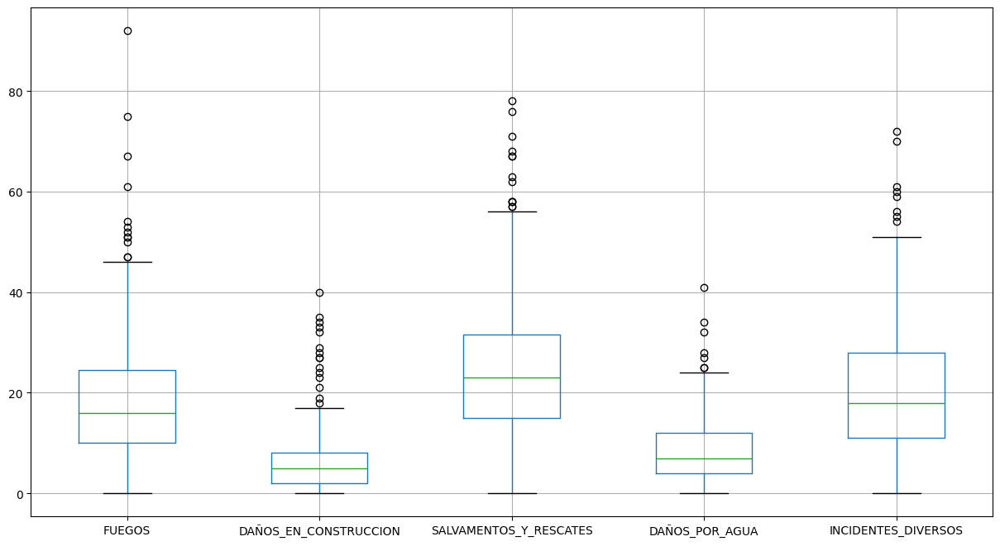

In [78]:
boxplot = pd.DataFrame.boxplot(data_loader.data['datasets/actuacionesBomberos'], column=['FUEGOS', 'DAÑOS_EN_CONSTRUCCION', 'SALVAMENTOS_Y_RESCATES','DAÑOS_POR_AGUA','INCIDENTES_DIVERSOS'], figsize=[15, 8])

In [79]:
pd.DataFrame.boxplot(data_loader.data['datasets/actuacionesBomberos'], column=['FUEGOS', 'DAÑOS_EN_CONSTRUCCION', 'SALVAMENTOS_Y_RESCATES','DAÑOS_POR_AGUA','INCIDENTES_DIVERSOS'], figsize=[15, 8])

<Axes: >

En este diagrama de cajas conjunto, podemos observar que salvamentos y rescates es el atributo con mayor dispersión (en cuanto a los límites inferiro y superior).

c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


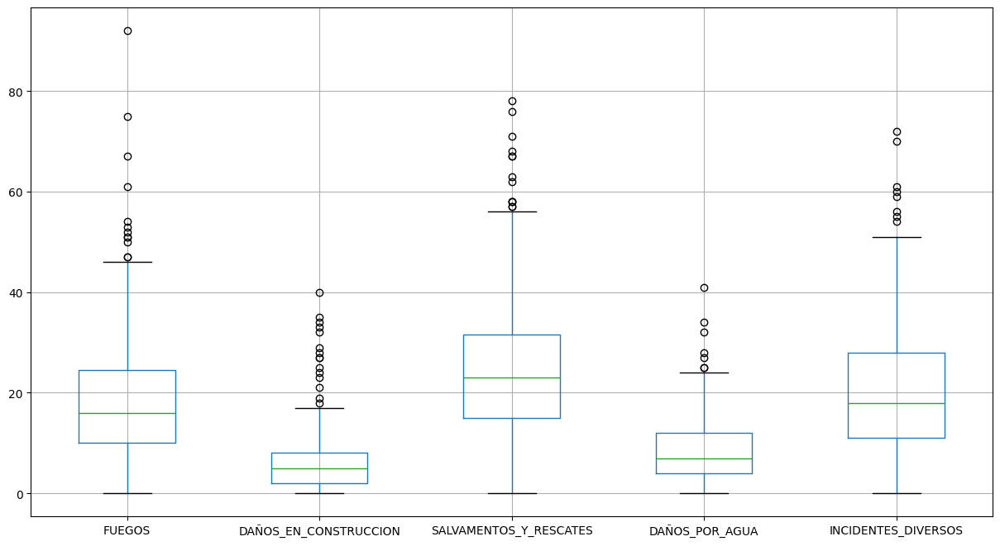

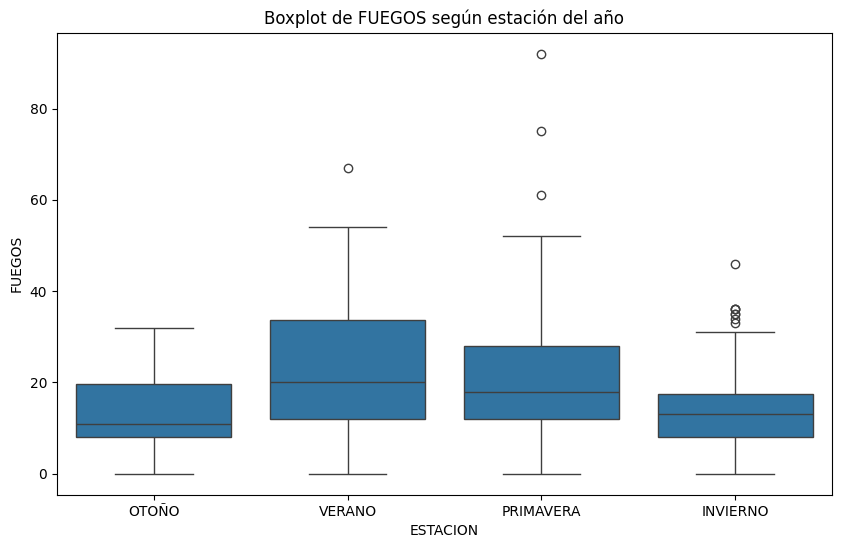

c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


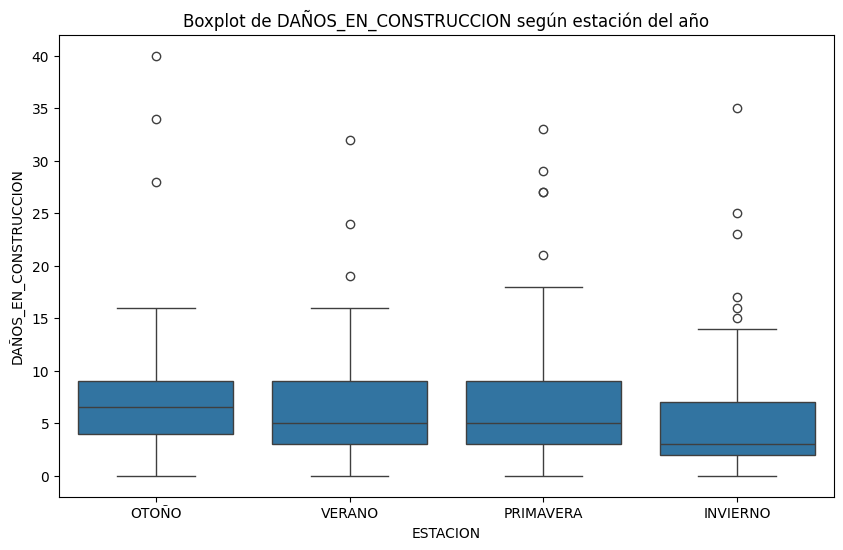

c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


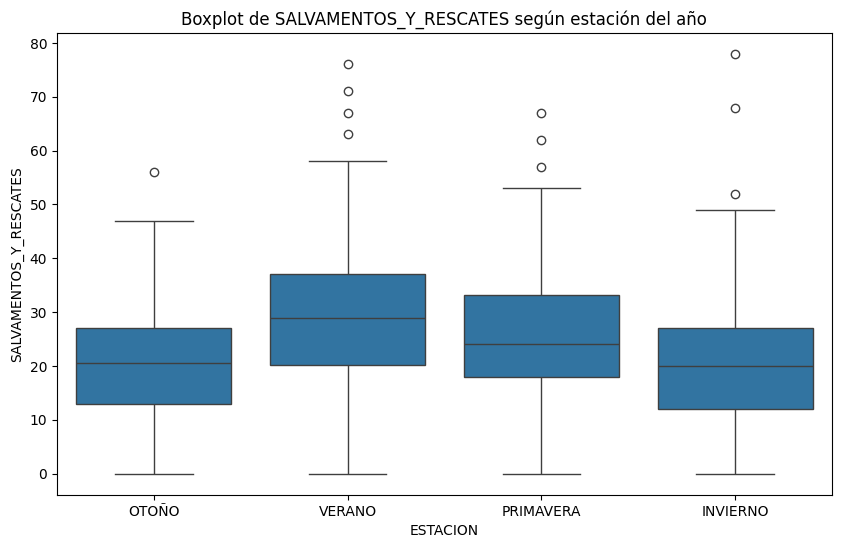

c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


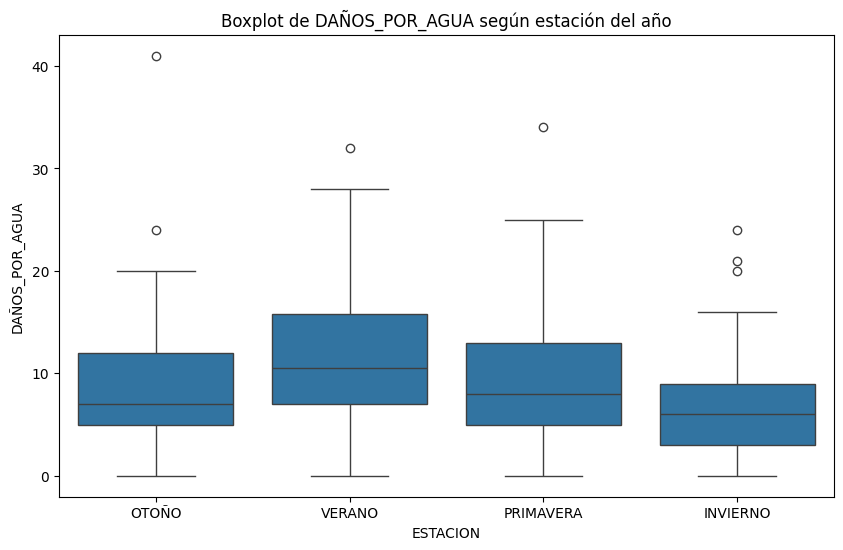

c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:640: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


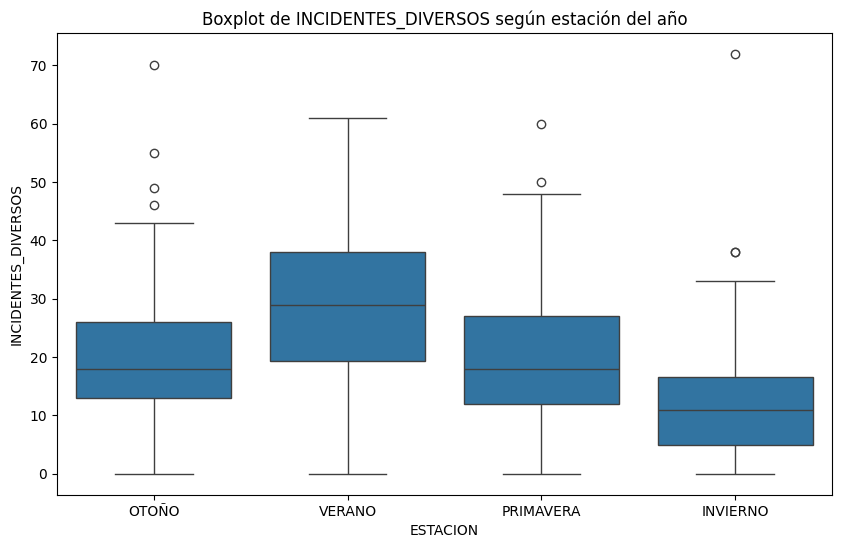

In [80]:
# Create boxplots for each column in each season
for column in tipoActuacion:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='ESTACION', y=column, data=data_loader.data['datasets/actuacionesBomberos'])
    plt.title(f'Boxplot de {column} según estación del año')
    plt.show()

In [81]:
# horas = ['HOR1', 'HOR2','HOR3', 'HOR4', 'HOR5', 'HOR6', 'HOR7', 'HOR8', 'HOR9', 'HOR10' , 'HOR11', 'HOR12', 'HOR13', 'HOR14', 'HOR15', 'HOR16', 'HOR17', 'HOR18', 'HOR19', 'HOR20', 'HOR21', 'HOR22', 'HOR23', 'HOR24']
# data_loader.data['datasets/estaciones'].plot.bar(x=horas, y=)

In [82]:
data_loader.get_info('datasets/accidentalidad')

NUM_EXPEDIENTE          0
FECHA                   0
HORA                    0
LOCALIZACION            0
NUMERO                  0
COD_DISTRITO            0
DISTRITO                0
TIPO_ACCIDENTE          0
ESTADO_METEOROLÓGICO    0
TIPO_VEHICULO           0
TIPO_PERSONA            0
RANGO_EDAD              0
SEXO                    0
COD_LESIVIDAD           0
LESIVIDAD               0
COORDENADA_X_UTM        0
COORDENADA_Y_UTM        0
POSITIVA_ALCOHOL        0
POSITIVA_DROGA          0
HOUR                    0
TIME_OF_DAY             0
TIPO_DIA                0
dtype: int64
<class 'pandas.core.frame.DataFrame'>
Index: 195610 entries, 0 to 31157
Data columns (total 22 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   NUM_EXPEDIENTE        195610 non-null  object        
 1   FECHA                 195610 non-null  datetime64[ns]
 2   HORA                  195610 non-null  object        
 3   LOCALIZACI

In [83]:
data_loader.dataframe_summary('datasets/accidentalidad')

,COD_DISTRITO,COD_LESIVIDAD,POSITIVA_DROGA,HOUR
count,195610.0,195610.0,195610.0,195610.0
mean,9.866111,11.717913,0.003113,14.15673
std,5.659225,4.089278,0.055711,5.714196
min,1.0,1.0,0.0,0.0
25%,5.0,7.0,0.0,10.0
50%,10.0,14.0,0.0,15.0
75%,14.0,14.0,0.0,19.0
max,21.0,77.0,1.0,23.0
counts,195610,195610,195610,195610
uniques,21,9,2,24


In [84]:
accidentes = data_loader.data['datasets/accidentalidad']
accidentes['FECHA'] = pd.to_numeric(accidentes.FECHA)

accidentes.plot(kind='scatter', x='FECHA', y='NUM_EXPEDIENTE')

<Axes: xlabel='FECHA', ylabel='NUM_EXPEDIENTE'>

In [85]:
data_loader.dataframe_summary('datasets/estaciones')

,HOR1,HOR2,HOR3,HOR4,HOR5,HOR6,HOR7,HOR8,HOR9,HOR10,...,HOR15,HOR16,HOR17,HOR18,HOR19,HOR20,HOR21,HOR22,HOR23,HOR24
count,43070.0,43070.0,43070.0,43070.0,43070.0,43070.0,43070.0,43070.0,43070.0,43070.0,...,43070.0,43070.0,43070.0,43070.0,43070.0,43070.0,43070.0,43070.0,43070.0,43070.0
mean,349.353866,249.446738,178.583074,143.306919,143.192686,228.891688,470.235663,770.226863,898.403065,897.940446,...,1006.635106,980.84632,959.616647,991.763594,1009.949269,987.990504,882.815997,734.660088,589.956675,462.854516
std,586.664755,435.311425,304.584859,223.363963,181.366051,253.470562,572.285139,1065.301401,1223.765007,1218.726208,...,1356.291987,1391.08328,1288.042121,1251.292668,1302.56987,1322.411338,1267.157291,1184.800883,973.216178,742.784157
min,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,74.0,46.0,34.0,30.0,38.0,56.0,98.0,171.0,232.0,274.0,...,333.0,303.0,308.0,334.0,344.0,335.0,290.0,223.0,162.0,118.0
50%,170.0,115.0,84.0,73.0,85.0,142.0,244.0,432.0,545.0,570.0,...,628.0,603.0,623.0,662.0,661.0,624.0,522.0,409.0,318.0,245.0
75%,378.0,264.0,195.0,158.0,179.0,323.0,625.0,1017.0,1089.0,1046.0,...,1224.0,1143.0,1138.0,1216.0,1245.0,1205.0,1032.0,815.0,672.0,533.0
max,9999.0,7854.0,9999.0,5805.0,3610.0,6234.0,5985.0,9999.0,9999.0,9999.0,...,9999.0,9999.0,9999.0,9999.0,9999.0,9999.0,9999.0,9999.0,9991.0,7557.0
counts,43070,43070,43070,43070,43070,43070,43070,43070,43070,43070,...,43070,43070,43070,43070,43070,43070,43070,43070,43070,43070
uniques,2444,2060,1594,1331,1192,1386,2647,3614,3986,3948,...,3942,3833,3630,3863,3924,3843,3789,3458,3096,2682


In [86]:
data_loader.dataframe_summary('DireccionesEvolucionHistorica_20231004.csv')

,COD_VIA,COD_NDP,NÚMERO,UTMX_ED,UTMY_ED,UTMX_ETRS,UTMY_ETRS,ANGULO_ROTULACION
count,371584.0,371584.0,371584.0,371584.0,371584.0,371584.0,371584.0,371584.0
mean,2408660.396707,17547202.021718,82.853409,410801.724511,4158100.407062,410795.750303,4158870.71411,168.249326
std,7645452.207957,8153265.087079,920.868559,113546.987911,1148626.440385,113359.935326,1146960.681354,140.842409
min,127.0,11000001.0,1.0,-1.0,-1.0,0.0,0.0,0.0
25%,140400.0,11052980.75,9.0,439182.795,4471012.1575,439075.81,4470806.235,33.81
50%,391700.0,11124680.5,21.0,441199.29,4475153.785,441091.2,4474947.51,86.64
75%,630200.0,20166508.75,47.0,444273.8625,4478740.51,444167.53,4478533.905,313.35
max,31006109.0,31071551.0,61000.0,455694.4,4495761.5,455584.93,4495554.04,360.0
counts,371584,371584,371584,371584,371584,371584,371584,371584
uniques,9464,253372,2106,213909,215667,213936,215543,21844


In [87]:
data_loader.dataframe_summary('DireccionesVigentes_20231004.csv')

,COD_VIA,NUMERO,COD_NDP,DISTRITO,BARRIO,COD_POSTAL,UTMX_ED,UTMY_ED,UTMX_ETRS,UTMY_ETRS
count,210384.0,210384.0,210384.0,210384.0,210384.0,210384.0,210384.0,210384.0,210384.0,210384.0
mean,2566230.727684,81.092307,17522404.731344,11.284119,3.750076,28029.558407,442135.7702,4474320.054455,442134.074194,4475197.192623
std,7927978.567944,1051.243757,8089368.83351,5.508962,2.017848,17.168581,8130.514821,69821.113228,4326.083981,4558.477391
min,127.0,0.0,11000001.0,1.0,1.0,28001.0,-1.0,-1.0,429028.19,4462609.77
25%,119000.0,8.0,11061237.75,8.0,2.0,28019.0,439609.1125,4471677.43,439501.805,4471471.88
50%,388100.0,19.0,11127486.5,11.0,4.0,28029.0,441821.96,4475526.82,441715.2,4475320.775
75%,632000.0,43.0,20164205.75,16.0,5.0,28041.0,445062.2625,4479130.2075,444954.04,4478923.4625
max,31006072.0,61000.0,31071551.0,21.0,9.0,28925.0,455694.4,4495761.5,455584.93,4495554.04
counts,210384,210384,210384,210384,210384,210384,210384,210384,210384,210384
uniques,8479,1244,210276,21,9,62,195058,196249,195042,196143


In [88]:
data_loader.dataframe_summary('iluminacion.csv')

,NUMERO,COD_NDP,DISTRITO,BARRIO,X_UTM,Y_UTM
count,231852.0,231852.0,231852.0,231852.0,231852.0,231852.0
mean,422.704182,19364601.663013,11.447216,3.775844,442251.705814,4474893.850316
std,3796.750322,8672057.496703,5.563872,1.989844,4411.047637,4641.998691
min,0.0,11000001.0,1.0,1.0,429019.1784,4464475.9552
25%,7.0,11074864.0,8.0,2.0,439474.186725,4471220.71195
50%,19.0,20020646.0,11.0,4.0,441890.7855,4474563.40805
75%,50.0,31016534.0,16.0,5.0,445434.235325,4478761.876075
max,61000.0,31068924.0,21.0,9.0,454625.6215,4487608.7979
counts,231852,231852,231852,231852,231852,231852
uniques,787,109999,21,9,231095,231087


In [89]:
data_loader.dataframe_summary('padron22.csv')

,Ï»¿EJERICIO,COD_DISTRITO,COD_BARRIO,CUOTA,CONTADOR
count,180345.0,180345.0,180345.0,180345.0,180345.0
mean,2022.0,9.889379,99.822352,81.910516,10.069434
std,0.0,5.90113,60.665245,67.361971,77.008243
min,2022.0,0.0,0.0,0.0,1.0
25%,2022.0,5.0,51.0,20.0,1.0
50%,2022.0,9.0,95.0,59.0,2.0
75%,2022.0,15.0,152.0,129.0,5.0
max,2022.0,21.0,215.0,266.0,7862.0
counts,180345,180345,180345,180345,180345
uniques,1,22,132,32,708


In [90]:
data_loader.dataframe_summary('RADARES_FIJOS_vDTT.csv')

,NUM_RADAR,LONGITUD,LATITUD
count,29.0,29.0,29.0
mean,15.0,-25894433.865636,27866574.092405
std,8.514693,96825860.328622,104192761.909893
min,1.0,-376358611.606955,4.039118
25%,8.0,-369.499826,40.397323
50%,15.0,-365.929627,4039.052318
75%,22.0,-3.709684,4045.892328
max,29.0,-0.373102,404072412.609861
counts,29,29,29
uniques,29,29,29


In [91]:
data_loader.dataframe_summary('VialesEvolucionHistorica_20231004.csv')

,COD_VIA,VIA_SQC
count,16446.0,16446.0
mean,4175345.431655,1.312842
std,10082926.753856,0.668149
min,125.0,1.0
25%,172206.25,1.0
50%,470175.0,1.0
75%,733057.5,1.0
max,99000000.0,13.0
counts,16446,16446
uniques,12554,13


In [92]:
data_loader.dataframe_summary('VialesVigentesDistritosBarrios_20231004.csv')

,COD_VIA,DISTRITO,BARRIO
count,11014.0,10990.0,10990.0
mean,4248101.971128,11.142493,3.605732
std,10196393.711887,5.739252,2.068502
min,127.0,1.0,0.0
25%,121825.0,7.0,2.0
50%,434000.0,11.0,3.0
75%,704068.75,16.0,5.0
max,31006183.0,21.0,9.0
counts,11014,10990,10990
uniques,9354,21,10


In [93]:
data_loader.dataframe_summary('VialesVigentesDistritos_20231004.csv')

,COD_VIA,DISTRITO
count,9839.0,9815.0
mean,4146937.609716,11.178502
std,10079147.61775,5.745088
min,127.0,1.0
25%,122475.0,7.0
50%,434650.0,11.0
75%,703150.0,16.0
max,31006183.0,21.0
counts,9839,9815
uniques,9354,21


In [94]:
data_loader.dataframe_summary('VialesVigentes_20231004.csv')

,COD_VIA,COD_VIA_COMIENZA,COD_VIA_TERMINA
count,9388.0,9388.0,9388.0
mean,4042814.759906,3466096.384001,8018823.443012
std,9961522.633361,11504118.496724,22587878.066217
min,127.0,127.0,127.0
25%,118493.75,139028.75,141550.0
50%,429850.0,419000.0,440375.0
75%,698962.5,667800.0,713200.0
max,31006183.0,99000003.0,99000003.0
counts,9388,9388,9388
uniques,9354,3446,3821


### Análisis exploratorio de los datos


Tabla de frecuencia relativa de accidentes por distritos. En esta tabla se obtiene la frecuencia de accidentes en todos los distritos de madrid, esto hace que se pueda obtener también el tráfico de coches en el distrito. Aunque no sea una relación proporcional, a mayor número de accidentes supone un tráfico mayor en la zona.

In [ ]:
data_loader.data['datasets/accidentalidad']['DISTRITO'] = data_loader.data['datasets/accidentalidad']['DISTRITO'].astype(str)
CSVDataLoader.create_graph(data_loader.data['datasets/accidentalidad'], 'DISTRITO', 'accidentes por distrito')

Tabla comparativa que muestra los accidentes donde la persona que lo ha padecido ha dado positivo en alcohol.

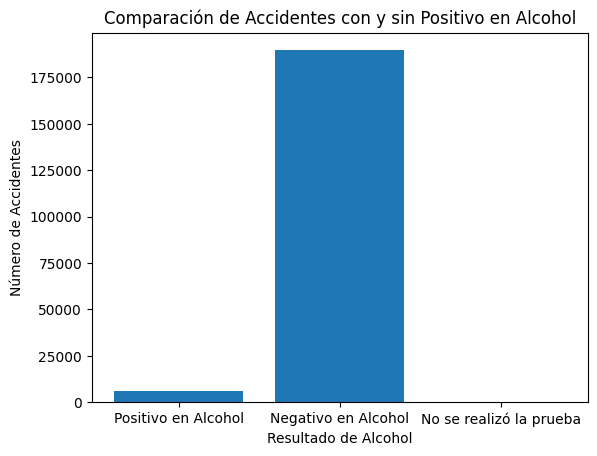

In [96]:
accidentes = data_loader.data['datasets/accidentalidad']
positivos = accidentes[accidentes['POSITIVA_ALCOHOL'] == 'S']
negativos = accidentes[accidentes['POSITIVA_ALCOHOL'] == 'N']
labels = ['Positivo en Alcohol', 'Negativo en Alcohol', 'No se realizó la prueba']
values = [len(positivos), len(negativos), len(accidentes) - len(positivos) - len(negativos)]
plt.bar(labels, values)
plt.xlabel('Resultado de Alcohol')
plt.ylabel('Número de Accidentes')
plt.title('Comparación de Accidentes con y sin Positivo en Alcohol')
plt.show()

Tabla comparativo donde la persona que ha padecido el accidente ha dado positivo en drogas.

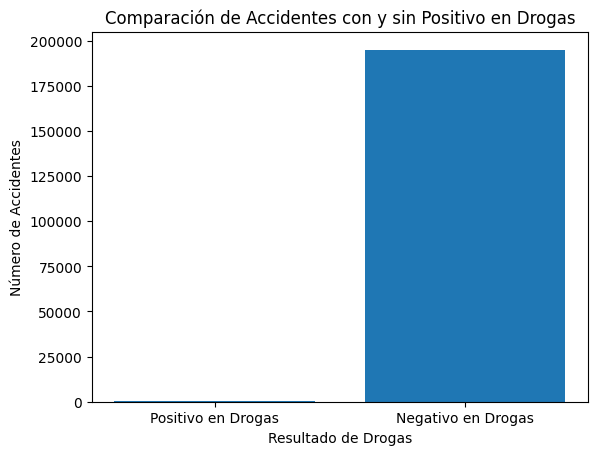

In [97]:
accidentes = data_loader.data['datasets/accidentalidad']
positivos = accidentes[accidentes['POSITIVA_DROGA'] == 1]
negativos = accidentes[accidentes['POSITIVA_DROGA'] == 0]
labels = ['Positivo en Drogas', 'Negativo en Drogas']
values = [len(positivos), len(negativos)]
plt.bar(labels, values)
plt.xlabel('Resultado de Drogas')
plt.ylabel('Número de Accidentes')
plt.title('Comparación de Accidentes con y sin Positivo en Drogas')
plt.show()

Tabla comparativa que relaciona los accidente en los que la persona ha dado positivo en alcohol y drogas

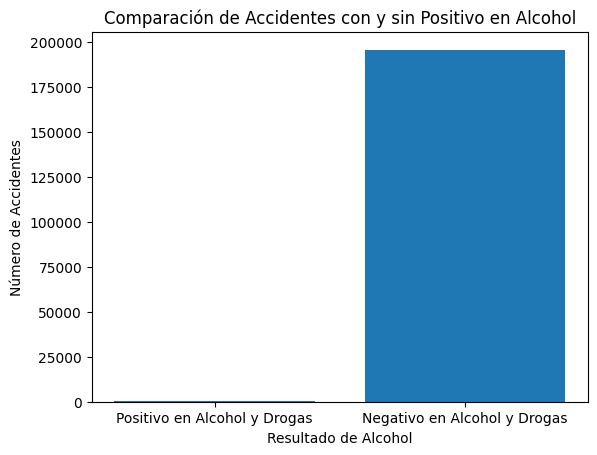

In [98]:
accidentes = data_loader.data['datasets/accidentalidad']
positivos_alcohol = accidentes[accidentes['POSITIVA_ALCOHOL'] == 'S']
positivos_drogas = accidentes[accidentes['POSITIVA_DROGA'] == 1]
positivos_alcohol_drogas = positivos_alcohol[positivos_alcohol['POSITIVA_DROGA'] == 1]
positivos_alcohol_drogas = len(positivos_alcohol_drogas)
negativos = len(accidentes) - positivos_alcohol_drogas
labels = ['Positivo en Alcohol y Drogas', 'Negativo en Alcohol y Drogas']
values = [positivos_alcohol_drogas, negativos]
plt.bar(labels, values)
plt.xlabel('Resultado de Alcohol')
plt.ylabel('Número de Accidentes')
plt.title('Comparación de Accidentes con y sin Positivo en Alcohol')
plt.show()

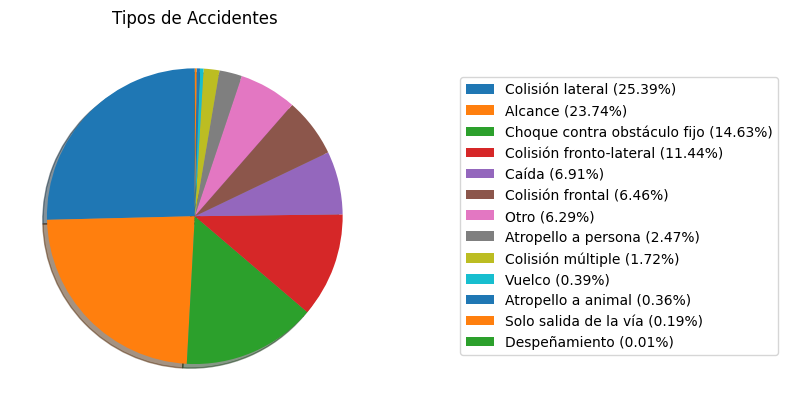

In [99]:
accidentes = data_loader.data['datasets/accidentalidad']
labels = accidentes['TIPO_ACCIDENTE'].unique()
# La siguiente línea eliminaba el valor 13.0 del gráfico antes de tener la solución definitiva en la limpieza actual
# labels = np.delete(labels, obj=13, axis=0)

values = accidentes['TIPO_ACCIDENTE'].value_counts()

percentages = (values / len(accidentes)) * 100

plt.pie(values, shadow=True, startangle=90)
plt.title('Tipos de Accidentes')
legend_labels = [f'{label} ({percentage:.2f}%)' for label, percentage in zip(labels, percentages)]
plt.legend(labels=legend_labels, loc='center left', bbox_to_anchor=(1.2, 0.5))
plt.show()

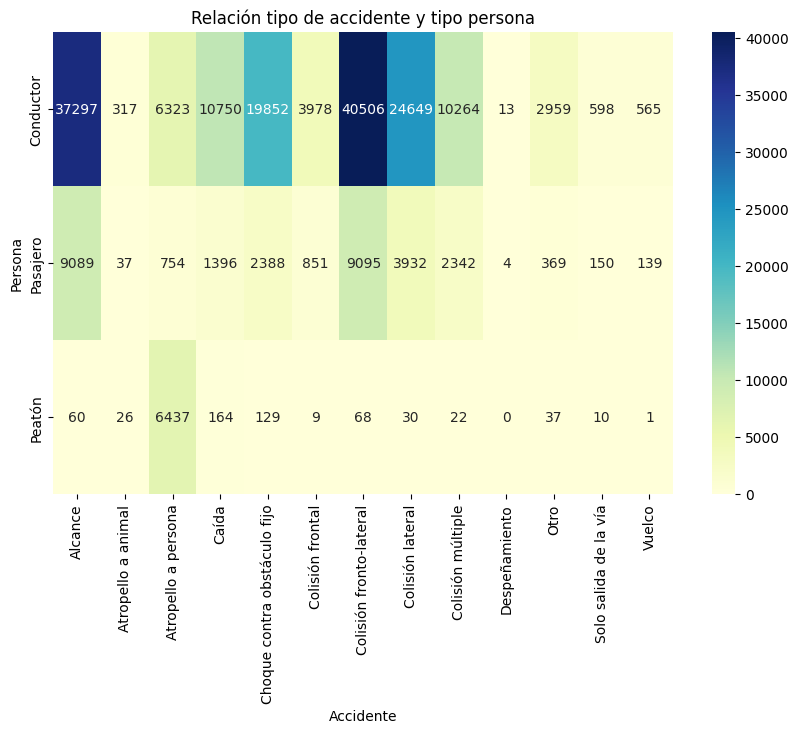

In [100]:
# Create a cross-tabulation of TIPO_PERSONA and TIPO_ACCIDENTE
cross_tab = pd.crosstab(accidentes['TIPO_PERSONA'], accidentes['TIPO_ACCIDENTE'])

# Plotting the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(cross_tab, annot=True, cmap="YlGnBu", fmt='g')
plt.title('Relación tipo de accidente y tipo persona')
plt.xlabel('Accidente')
plt.ylabel('Persona')

plt.show()

c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.g

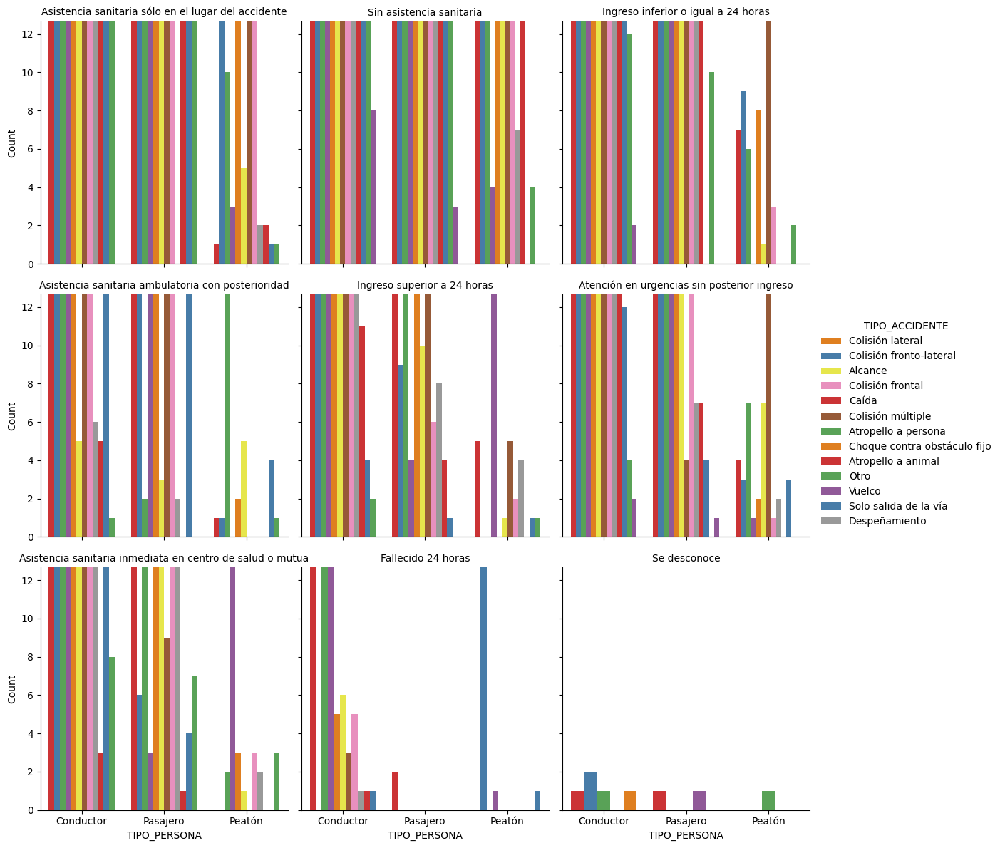

In [101]:
# Sample data (replace with your DataFrame)
accidentes = data_loader.data['datasets/accidentalidad']

# Create a faceted plot
g = sns.FacetGrid(accidentes, col='LESIVIDAD', height=4, col_wrap=3)
g.map_dataframe(sns.countplot, x='TIPO_PERSONA', hue='TIPO_ACCIDENTE', palette='Set1', order=accidentes['TIPO_PERSONA'].value_counts().index)
g.set_axis_labels('TIPO_PERSONA', 'Count')
g.set_titles(col_template='{col_name}')

# Iterate through each subplot and set y-axis limits
for ax, lesividad in zip(g.axes.flat, accidentes['LESIVIDAD'].unique()):
    subset_data = accidentes[accidentes['LESIVIDAD'] == lesividad]
    mean_count = subset_data.groupby('TIPO_PERSONA').size().mean()

    # Check for NaN or Inf before setting the limits
    if np.isfinite(mean_count):
        ax.set_ylim(0, mean_count + 10)  # Adjust the limits based on the maximum count in each subplot

# Add a legend
g.add_legend(title='TIPO_ACCIDENTE')

plt.show()

c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.g

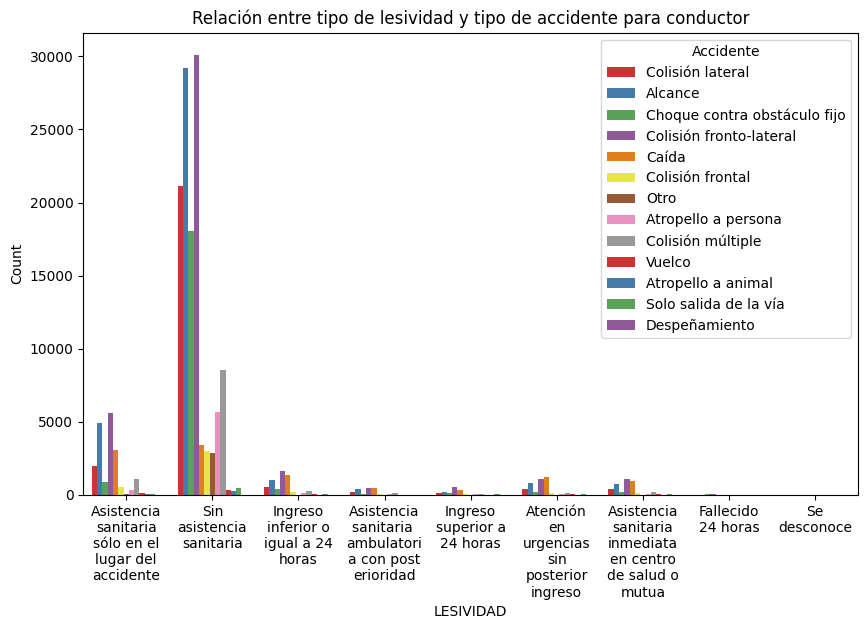

In [102]:
# Filter the DataFrame for cases where TIPO_PERSONA is 'Driver'
df_driver = accidentes[accidentes['TIPO_PERSONA'] == 'Conductor']

# Create a grouped bar plot
plt.figure(figsize=(10, 6))
plot = sns.countplot(data=df_driver, x='LESIVIDAD', hue='TIPO_ACCIDENTE', palette='Set1')

# Wrap the x-axis labels
wrapped_labels = [textwrap.fill(label.get_text(), 10) for label in plot.get_xticklabels()]
plot.set_xticklabels(wrapped_labels)

plt.title('Relación entre tipo de lesividad y tipo de accidente para conductor')
plt.xlabel('LESIVIDAD')
plt.ylabel('Count')
plt.legend(title='Accidente')

plt.show()

c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.g

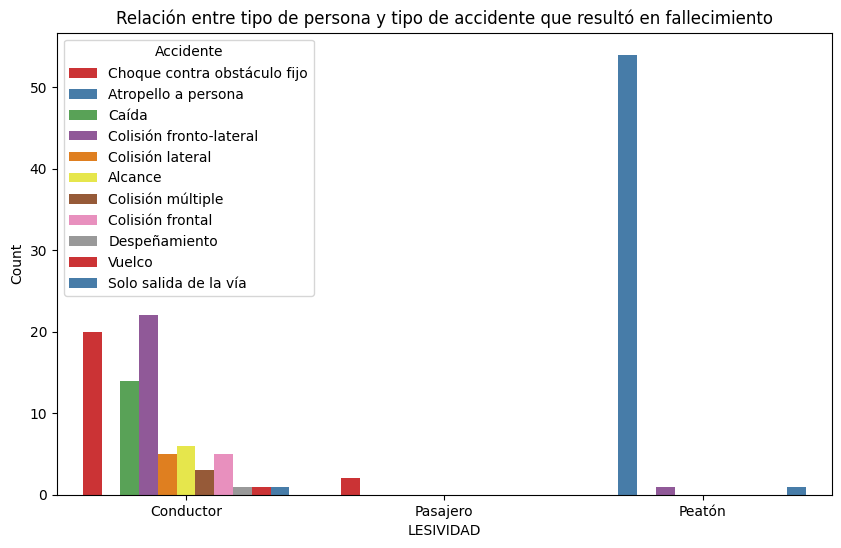

In [103]:
df_dead = accidentes[accidentes['COD_LESIVIDAD'] == 4]

# Create a grouped bar plot
plt.figure(figsize=(10, 6))
plot = sns.countplot(data=df_dead, x='TIPO_PERSONA', hue='TIPO_ACCIDENTE', palette='Set1')

# Wrap the x-axis labels
wrapped_labels = [textwrap.fill(label.get_text(), 10) for label in plot.get_xticklabels()]
plot.set_xticklabels(wrapped_labels)

plt.title('Relación entre tipo de persona y tipo de accidente que resultó en fallecimiento')
plt.xlabel('LESIVIDAD')
plt.ylabel('Count')
plt.legend(title='Accidente')

plt.show()

C:\Users\paula\AppData\Local\Temp\ipykernel_27348\1956786289.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df_peaton, x='ESTADO_METEOROLÓGICO', palette='dark')
c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key

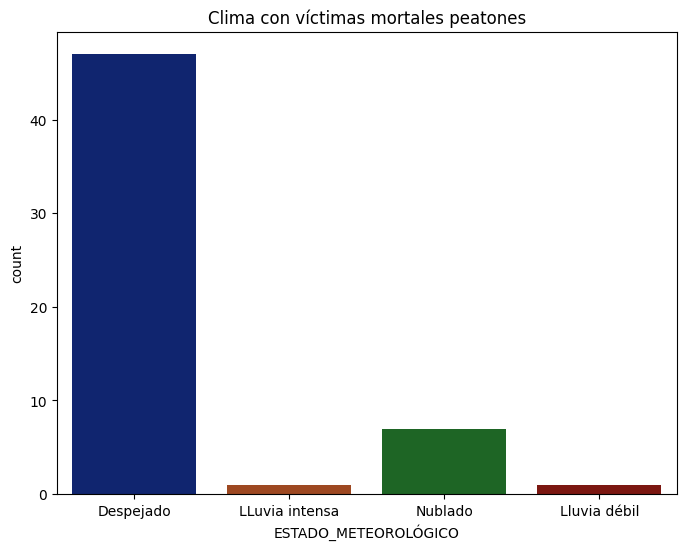

In [104]:
df_peaton = accidentes[(accidentes['TIPO_PERSONA'] == 'Peatón') & (accidentes['COD_LESIVIDAD'] == 4)]

# Plot the count of ESTADO_METEOROLOGICO
plt.figure(figsize=(8, 6))
sns.countplot(data=df_peaton, x='ESTADO_METEOROLÓGICO', palette='dark')
plt.title('Clima con víctimas mortales peatones')
plt.show()

In [105]:
estaciones = data_loader.data['datasets/estaciones']


In [106]:
data_loader.get_info('datasets/estaciones')

HOR1     0
HOR2     0
HOR3     0
HOR4     0
HOR5     0
HOR6     0
HOR7     0
HOR8     0
HOR9     0
HOR10    0
HOR11    0
HOR12    0
HOR13    0
HOR14    0
HOR15    0
HOR16    0
HOR17    0
HOR18    0
HOR19    0
HOR20    0
HOR21    0
HOR22    0
HOR23    0
HOR24    0
dtype: int64
<class 'pandas.core.frame.DataFrame'>
MultiIndex: 43070 entries, ('ES01', Timestamp('2022-08-01 00:00:00'), '1') to ('ES60', Timestamp('2023-07-31 00:00:00'), '2')
Data columns (total 24 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   HOR1    43070 non-null  float64
 1   HOR2    43070 non-null  float64
 2   HOR3    43070 non-null  float64
 3   HOR4    43070 non-null  float64
 4   HOR5    43070 non-null  float64
 5   HOR6    43070 non-null  float64
 6   HOR7    43070 non-null  float64
 7   HOR8    43070 non-null  float64
 8   HOR9    43070 non-null  float64
 9   HOR10   43070 non-null  float64
 10  HOR11   43070 non-null  float64
 11  HOR12   43070 non-null  float64
 12  HOR

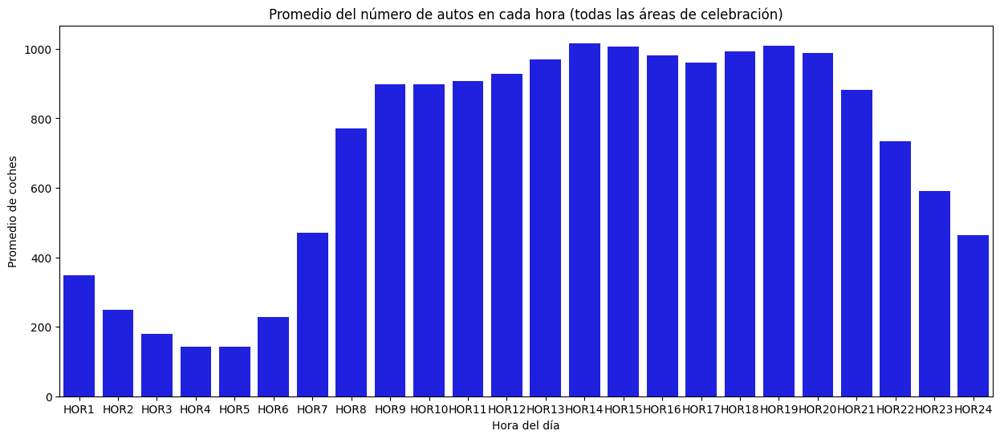

In [107]:
# Calculate the average number of cars for each hour
average_cars_per_hour = estaciones[['HOR1', 'HOR2', 'HOR3', 'HOR4', 'HOR5', 'HOR6', 'HOR7', 'HOR8', 'HOR9', 'HOR10', 'HOR11', 'HOR12', 'HOR13', 'HOR14', 'HOR15', 'HOR16', 'HOR17', 'HOR18', 'HOR19', 'HOR20', 'HOR21', 'HOR22', 'HOR23', 'HOR24']].mean(axis=0)

# Create a bar plot for the average number of cars at each hour
plt.figure(figsize=(15, 6))
sns.barplot(x=average_cars_per_hour.index, y=average_cars_per_hour.values, color='blue')
plt.title('Promedio del número de autos en cada hora (todas las áreas de celebración)')
plt.xlabel('Hora del día')
plt.ylabel('Promedio de coches')
plt.show()

In [108]:
direccionesvigentes = data_loader.data['DireccionesVigentes_20231004.csv']

In [109]:
data_loader.get_info('padron22.csv')

Ï»¿EJERICIO                 0
COD_TIPO_PERSONA            0
TIPO_PERSONA                0
COD_DISTRITO                0
DISTRITO                    0
COD_BARRIO                  0
BARRIO                      0
COD_TIPO_VEHÃCULO          0
TIPO_VEHÃCULO              0
ETIQUETA_MEDIOAMBIENTAL     0
CLASIFICACIÃN_AMBIENTAL    0
CUOTA                       0
TIPO_CARBURANTE             0
AÃO_MATRICULACIÃN         0
CONTADOR                    0
dtype: int64
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 180345 entries, 0 to 180344
Data columns (total 15 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Ï»¿EJERICIO               180345 non-null  int64  
 1   COD_TIPO_PERSONA          180345 non-null  object 
 2   TIPO_PERSONA              180345 non-null  object 
 3   COD_DISTRITO              180345 non-null  int64  
 4   DISTRITO                  180345 non-null  object 
 5   COD_BARRIO                180

In [110]:
data_loader.data['padron22.csv'] = data_loader.data['padron22.csv'].rename(columns={'TIPO_VEHÃCULO': 'TIPO_VEHICULO'})
data_loader.data['padron22.csv'] = data_loader.data['padron22.csv'].rename(columns={'COD_TIPO_VEHÃCULO': 'COD_TIPO_VEHICULO'})

padron = data_loader.data['padron22.csv']
print(data_loader.data['padron22.csv']['COD_TIPO_VEHICULO'].unique())



['CA' 'MT' 'RE' 'TR' 'TU' 'CI' 'AU' 'SE']


Este gráfico muestra los distintos tipos de accidentes registrados. Se puede ver que la colisión frontal-lateral y el alcance son las mauores causas de accidentes.

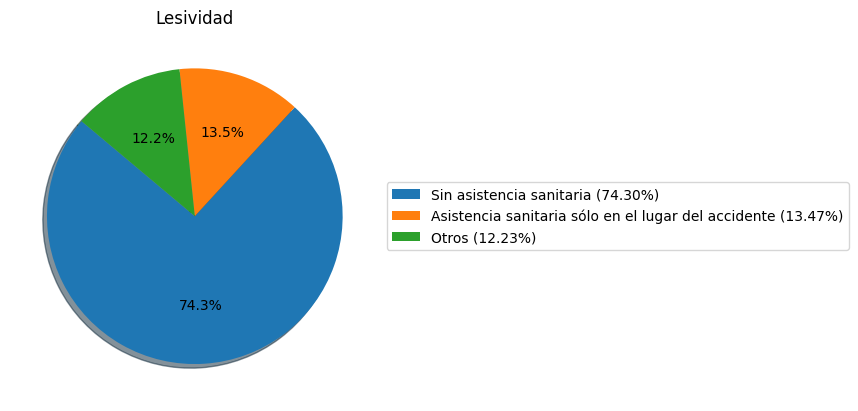

In [111]:
accidentes = data_loader.data['datasets/accidentalidad']
values = accidentes['LESIVIDAD'].value_counts()
labels = values.index
percentages = (values / len(accidentes)) * 100
umbral = 5
categorias_otras = labels[percentages < umbral]
values['Otros'] = values[percentages < umbral].sum()
values = values.drop(index=categorias_otras)
percentages = (values / len(accidentes)) * 100
plt.pie(values, shadow=True, autopct='%1.1f%%', startangle=140)
plt.title('Lesividad')
legend_labels = [f'{label} ({percentage:.2f}%)' for label, percentage in zip(values.index, percentages)]
plt.legend(labels=legend_labels, loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

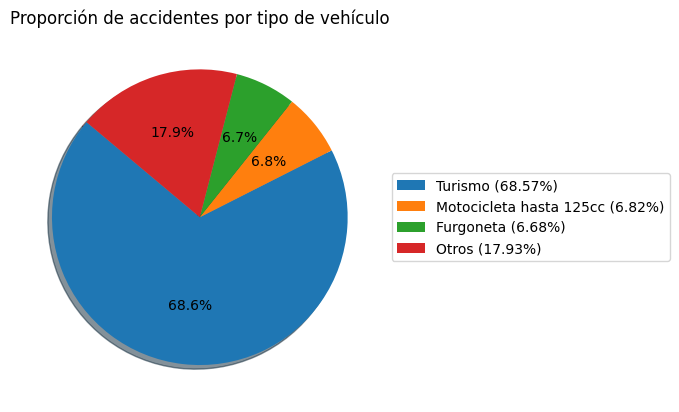

In [112]:
accidentes = data_loader.data['datasets/accidentalidad']
values = accidentes['TIPO_VEHICULO'].value_counts()
labels = values.index
percentages = (values / len(accidentes)) * 100
umbral = 5
categorias_otras = labels[percentages < umbral]
values['Otros'] = values[percentages < umbral].sum()
values = values.drop(index=categorias_otras)
percentages = (values / len(accidentes)) * 100
plt.pie(values, shadow=True, autopct='%1.1f%%', startangle=140)
plt.title('Proporción de accidentes por tipo de vehículo')
legend_labels = [f'{label} ({percentage:.2f}%)' for label, percentage in zip(values.index, percentages)]
plt.legend(labels=legend_labels, loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

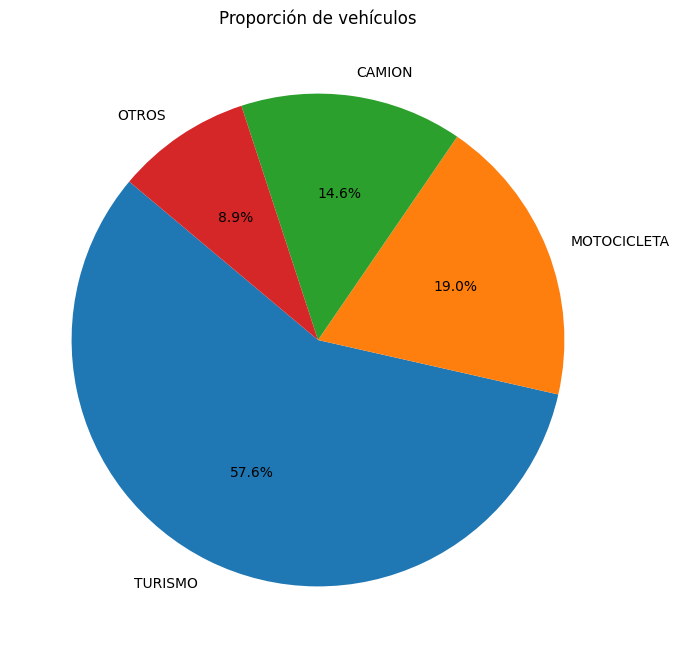

In [113]:
padron = data_loader.data['padron22.csv']

# Count the occurrences of each type of vehicle
vehicle_counts = padron['TIPO_VEHICULO'].value_counts()

# Identify values with frequency under 10%
threshold = 0.10 * len(padron)  # 10% of the total length of the DataFrame
values_to_group = vehicle_counts[vehicle_counts < threshold].index

# Replace values with frequency under 10% with 'OTROS'
padron['TIPO_VEHICULO'] = padron['TIPO_VEHICULO'].apply(lambda x: 'OTROS' if x in values_to_group else x)

# Recalculate the frequency after grouping
grouped_vehicle_counts = padron['TIPO_VEHICULO'].value_counts()

# Plot a pie chart
plt.figure(figsize=(10, 8))
plt.pie(grouped_vehicle_counts, labels=grouped_vehicle_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Proporción de vehículos')
plt.show()

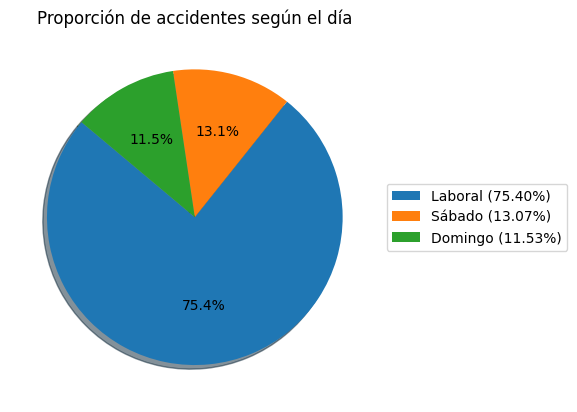

In [114]:
accidentes = data_loader.data['datasets/accidentalidad']
values = accidentes['TIPO_DIA'].value_counts()
labels = values.index
percentages = (values / len(accidentes)) * 100
plt.pie(values, shadow=True, autopct='%1.1f%%', startangle=140)
plt.title('Proporción de accidentes según el día')
legend_labels = [f'{label} ({percentage:.2f}%)' for label, percentage in zip(labels, percentages)]
plt.legend(labels=legend_labels, loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

In [115]:
data_loader.get_info('iluminacion.csv')

TIPO_BLOQU       0
TIPO             0
VIA_CLASE        0
VIA_PAR       8582
VIA_NOMBRE       0
CLASE_APP        0
NUMERO           0
COD_NDP          0
DISTRITO         0
BARRIO           0
X_UTM            0
Y_UTM            0
dtype: int64
<class 'pandas.core.frame.DataFrame'>
Index: 231852 entries, 0 to 233308
Data columns (total 12 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   TIPO_BLOQU  231852 non-null  object 
 1   TIPO        231852 non-null  object 
 2   VIA_CLASE   231852 non-null  object 
 3   VIA_PAR     223270 non-null  object 
 4   VIA_NOMBRE  231852 non-null  object 
 5   CLASE_APP   231852 non-null  object 
 6   NUMERO      231852 non-null  int64  
 7   COD_NDP     231852 non-null  int64  
 8   DISTRITO    231852 non-null  int64  
 9   BARRIO      231852 non-null  int64  
 10  X_UTM       231852 non-null  float64
 11  Y_UTM       231852 non-null  float64
dtypes: float64(2), int64(4), object(6)
memory usage: 23.0+ MB
No

In [116]:
def convert_to_latlon(row):
    try:
        easting = float(row['COORDENADA_X_UTM'].replace(',', '.'))
        northing = float(row['COORDENADA_Y_UTM'].replace(',', '.'))
        return utm.to_latlon(easting, northing, zone_number=30, zone_letter='T')
    except (ValueError, AttributeError):
        return None, None
accidentes['LAT'], accidentes['LONG'] = zip(*accidentes.apply(convert_to_latlon, axis=1))

In [117]:
data_loader.get_info('iluminacion.csv')

TIPO_BLOQU       0
TIPO             0
VIA_CLASE        0
VIA_PAR       8582
VIA_NOMBRE       0
CLASE_APP        0
NUMERO           0
COD_NDP          0
DISTRITO         0
BARRIO           0
X_UTM            0
Y_UTM            0
dtype: int64
<class 'pandas.core.frame.DataFrame'>
Index: 231852 entries, 0 to 233308
Data columns (total 12 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   TIPO_BLOQU  231852 non-null  object 
 1   TIPO        231852 non-null  object 
 2   VIA_CLASE   231852 non-null  object 
 3   VIA_PAR     223270 non-null  object 
 4   VIA_NOMBRE  231852 non-null  object 
 5   CLASE_APP   231852 non-null  object 
 6   NUMERO      231852 non-null  int64  
 7   COD_NDP     231852 non-null  int64  
 8   DISTRITO    231852 non-null  int64  
 9   BARRIO      231852 non-null  int64  
 10  X_UTM       231852 non-null  float64
 11  Y_UTM       231852 non-null  float64
dtypes: float64(2), int64(4), object(6)
memory usage: 23.0+ MB
No

In [118]:
import geopandas as gpd
from shapely.geometry import Point

# Assuming your DataFrame is named accidentes
# If your DataFrame is named differently, replace accidentes with your DataFrame's name
iluminacion = data_loader.data['iluminacion.csv']

decimals = 6

# Round the values in 'X_UTM' and 'Y_UTM' columns
iluminacion['X_UTM'] = iluminacion['X_UTM'].round(decimals)
iluminacion['Y_UTM'] = iluminacion['Y_UTM'].round(decimals)

# Convert UTM coordinates to GeoDataFrame
geometry = [Point(easting, northing) for easting, northing in zip(iluminacion['X_UTM'], iluminacion['Y_UTM'])]
gdf = gpd.GeoDataFrame(iluminacion, geometry=geometry, crs="EPSG:32630") 

# Define valid bounding box
valid_easting_range = (100000, 999999)
valid_northing_range = (0, 10000000)  # Assuming a reasonable northing range, adjust if needed

# Filter out-of-range points
filtered_gdf = gdf.cx[valid_easting_range[0]:valid_easting_range[1], valid_northing_range[0]:valid_northing_range[1]]

# Convert back to original DataFrame
f = filtered_gdf.drop(columns='geometry')

# Display the updated DataFrame
print(f.head())


  TIPO_BLOQU      TIPO VIA_CLASE VIA_PAR     VIA_NOMBRE CLASE_APP  NUMERO  \
0     LBE002  DESCARGA     CALLE  DE LAS           ERAS    NUMERO       3   
1     LBE002  DESCARGA     CALLE  DE LAS           ERAS    NUMERO      10   
2    GLED001       LED     PLAZA      DE  MAR DEL PLATA    NUMERO      12   
3   FFLED005       LED     CALLE     DEL   MAR AMARILLO    NUMERO      21   
4   FFLED005       LED     CALLE     DEL   MAR AMARILLO    NUMERO      19   

    COD_NDP  DISTRITO  BARRIO        X_UTM         Y_UTM  
0  20040016        16       4  445648.4812  4.480671e+06  
1  31024246        16       4  445610.6416  4.480741e+06  
2  11119324        16       4  445680.0750  4.480679e+06  
3  11119327        16       4  445669.5353  4.480645e+06  
4  11119326        16       4  445651.1627  4.480635e+06  


In [119]:
iluminacion.head()

,TIPO_BLOQU,TIPO,VIA_CLASE,VIA_PAR,VIA_NOMBRE,CLASE_APP,NUMERO,COD_NDP,DISTRITO,BARRIO,X_UTM,Y_UTM
0,LBE002,DESCARGA,CALLE,DE LAS,ERAS,NUMERO,3,20040016,16,4,445648.4812,4.480671e+06
1,LBE002,DESCARGA,CALLE,DE LAS,ERAS,NUMERO,10,31024246,16,4,445610.6416,4.480741e+06
2,GLED001,LED,PLAZA,DE,MAR DEL PLATA,NUMERO,12,11119324,16,4,445680.0750,4.480679e+06
3,FFLED005,LED,CALLE,DEL,MAR AMARILLO,NUMERO,21,11119327,16,4,445669.5353,4.480645e+06
4,FFLED005,LED,CALLE,DEL,MAR AMARILLO,NUMERO,19,11119326,16,4,445651.1627,4.480635e+06


In [120]:
#iluminacion['LAT'], iluminacion['LONG'] = zip(*iluminacion.apply(lambda row: utm.to_latlon(float(row['X_UTM']), float(row['Y_UTM']), zone_number=30, zone_letter='T'), axis=1))

In [121]:
data_loader.get_info('datasets/accidentalidad')

NUM_EXPEDIENTE              0
FECHA                       0
HORA                        0
LOCALIZACION                0
NUMERO                      0
COD_DISTRITO                0
DISTRITO                    0
TIPO_ACCIDENTE              0
ESTADO_METEOROLÓGICO        0
TIPO_VEHICULO               0
TIPO_PERSONA                0
RANGO_EDAD                  0
SEXO                        0
COD_LESIVIDAD               0
LESIVIDAD                   0
COORDENADA_X_UTM            0
COORDENADA_Y_UTM            0
POSITIVA_ALCOHOL            0
POSITIVA_DROGA              0
HOUR                        0
TIME_OF_DAY                 0
TIPO_DIA                    0
LAT                     29929
LONG                    29929
dtype: int64
<class 'pandas.core.frame.DataFrame'>
Index: 195610 entries, 0 to 31157
Data columns (total 24 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   NUM_EXPEDIENTE        195610 non-null  object  
 1 

In [122]:
47039/195605

0.24047953784412465

In [123]:
# Assuming your DataFrame is named accidentes
# If your DataFrame is named differently, replace accidentes with your DataFrame's name

# Check occurrences of '#¡VALOR!' in 'COORDENADA_X_UTM' column
valor_occurrences_x = data_loader.data['datasets/accidentalidad'][data_loader.data['datasets/accidentalidad']['COORDENADA_X_UTM'] == '#¡VALOR!']

# Check occurrences of '#¡VALOR!' in 'COORDENADA_Y_UTM' column
valor_occurrences_y = data_loader.data['datasets/accidentalidad'][data_loader.data['datasets/accidentalidad']['COORDENADA_Y_UTM'] == '#¡VALOR!']

# Display the occurrences
print(len(valor_occurrences_x))
print(len(valor_occurrences_y))
print("Occurrences in COORDENADA_X_UTM:")
print(valor_occurrences_x)

print("\nOccurrences in COORDENADA_Y_UTM:")
print(valor_occurrences_y)


30
30
Occurrences in COORDENADA_X_UTM:
      NUM_EXPEDIENTE                FECHA      HORA  \
29308    2019S026997  1563840000000000000  08:45:00   
29309    2019S026997  1563840000000000000  08:45:00   
17953    2020S011111  1596931200000000000  18:10:00   
17954    2020S011111  1596931200000000000  18:10:00   
17955    2020S011111  1596931200000000000  18:10:00   
20493    2020S012560  1599955200000000000  17:45:00   
20494    2020S012560  1599955200000000000  17:45:00   
20495    2020S012560  1599955200000000000  17:45:00   
30817    2021S018891  1634428800000000000  12:20:00   
30818    2021S018891  1634428800000000000  12:20:00   
37939    2021S022950  1638489600000000000  06:30:00   
37940    2021S022950  1638489600000000000  06:30:00   
39443    2021S023850  1639440000000000000  09:10:00   
39444    2021S023850  1639440000000000000  09:10:00   
39445    2021S023850  1639440000000000000  09:10:00   
41231    2021S024803  1640563200000000000  02:10:00   
41425    2021S024915  1640

In [124]:
data_loader.get_info('datasets/accidentalidad')

NUM_EXPEDIENTE              0
FECHA                       0
HORA                        0
LOCALIZACION                0
NUMERO                      0
COD_DISTRITO                0
DISTRITO                    0
TIPO_ACCIDENTE              0
ESTADO_METEOROLÓGICO        0
TIPO_VEHICULO               0
TIPO_PERSONA                0
RANGO_EDAD                  0
SEXO                        0
COD_LESIVIDAD               0
LESIVIDAD                   0
COORDENADA_X_UTM            0
COORDENADA_Y_UTM            0
POSITIVA_ALCOHOL            0
POSITIVA_DROGA              0
HOUR                        0
TIME_OF_DAY                 0
TIPO_DIA                    0
LAT                     29929
LONG                    29929
dtype: int64
<class 'pandas.core.frame.DataFrame'>
Index: 195610 entries, 0 to 31157
Data columns (total 24 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   NUM_EXPEDIENTE        195610 non-null  object  
 1 

In [125]:
data_loader.get_info('RADARES_FIJOS_vDTT.csv')

NUM_RADAR                0
UBICACION                0
CARRETARA_O_VIAL         1
UBICACIÓN\r\nCALLE_30    8
PK                       1
SENTIDO                  3
TIPO                     3
LONGITUD                 0
LATITUD                  0
COORDENADAS              0
dtype: int64
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29 entries, 0 to 28
Data columns (total 10 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   NUM_RADAR            29 non-null     int64  
 1   UBICACION            29 non-null     object 
 2   CARRETARA_O_VIAL     28 non-null     object 
 3   UBICACIÓN
CALLE_30  21 non-null     object 
 4   PK                   28 non-null     object 
 5   SENTIDO              26 non-null     object 
 6   TIPO                 26 non-null     object 
 7   LONGITUD             29 non-null     float64
 8   LATITUD              29 non-null     float64
 9   COORDENADAS          29 non-null     object 
dtypes: float64

In [126]:
radares = data_loader.data['RADARES_FIJOS_vDTT.csv']
radares

,NUM_RADAR,UBICACION,CARRETARA_O_VIAL,UBICACIÓN\r\nCALLE_30,PK,SENTIDO,TIPO,LONGITUD,LATITUD,COORDENADAS
0,1,"M-30, ENTRADA DE LA A-1, SENTIDO PUENTE DE VEN...",M-30,00NC50,0+500,Calzada interior,Fijo carriles 3 y 4,-3.674338e+02,4.047934e+03,DGP
1,2,"M-30, ENTRADA DE LA A-1, SENTIDO PUENTE DE VEN...",M-30,00NC50,0+500,Calzada interior,Fijo carriles 3 y 4,-3.674291e+02,4.047934e+03,DGP
2,3,"PASO INFERIOR COSTA RICA, SENTIDO PRÍNCIPE DE ...",NaN,NaN,NaN,NaN,NaN,-3.668803e+02,4.045892e+03,DGP
3,4,"M-30, PTE. DE VENTAS. SENTIDO SUR A O´DONNELL ...",M-30,M-30,6+700,Tronco calzada interior,"Fijo carriles 1, 2 y 3",-3.660144e+02,4.042618e+03,DGP
4,5,"M-30, PTE. DE VENTAS. SENTIDO SUR A O´DONNELL ...",M-30,M-30,6+700,Tronco calzada interior,"Fijo carriles 1, 2 y 3",-3.660061e+02,4.042619e+03,DGP
5,6,"M-30, ENLACE O´DONNELL SENTIDO NORTE A PTE. DE...",M-30,M-30,7+800,Tronco calzada exterior,Fijo carriles 2 y 3,-3.659261e+02,4.041664e+03,DGP
6,7,"M-30, ENLACE O´DONNELL SENTIDO NORTE A PTE. DE...",M-30,M-30,7+800,Tronco calzada exterior,Fijo carriles 2 y 3,-3.659296e+02,4.041664e+03,DGP
7,8,"TÚNEL BAIPÁS, SENTIDO NORTE A PTE. DE VENTAS (...",M-30,10XC30,10+300,Calzada exterior,Fijo carril 1,-3.670048e+00,4.039735e+01,Calle30
8,9,"TÚNEL BAIPÁS, SENTIDO NORTE A PTE. DE VENTAS (...",M-30,10XC30,10+300,Calzada exterior,Fijo carril 3,-3.669973e+00,4.039732e+01,Calle30
9,10,"ENTRADA TÚNEL M-30, DESDE NUDO SUR HACIA PTE. ...",M-30,13NL25,13+250,Calzada interior,Fijo carril 3,-3.694998e+02,4.038679e+03,Calle30


In [127]:
from folium.plugins import MarkerCluster
def utm_to_latlon(utm_x, utm_y, zone_number=30, zone_letter='T'):
    """
    Convert UTM coordinates to Latitude and Longitude.
    Assumes zone number 30 and zone letter 'T' for Madrid.
    """
    try:
        lat, lon = utm.to_latlon(utm_x, utm_y, zone_number, zone_letter)
        return lat, lon
    except Exception as e:
        print("Error en la conversión:", e, " utmx: ", utm_x, "utmy: ", utm_y, " ")
        return None, None
coordinates = data_loader.data['datasets/accidentalidad'].filter(items=['COORDENADA_X_UTM', 'COORDENADA_Y_UTM', 'TIPO_ACCIDENTE', 'TIPO_VEHICULO'])
coordinates.columns = ['utm_x', 'utm_y', 'tipo_accidente', 'tipo_vehiculo']
coordinates['lat'], coordinates['lon'] = zip(*coordinates.apply(lambda row: utm_to_latlon(row['utm_x'], row['utm_y']), axis=1))
coordinates.dropna(subset=['lat', 'lon'], inplace=True)
madrid_map_clustered = folium.Map(location=[40.4168, -3.7038], zoom_start=12)
marker_cluster = MarkerCluster().add_to(madrid_map_clustered)
for idx, row in coordinates.iterrows():
    label = f'Lat: {row["lat"]}, Lon: {row["lon"]}, \nAccidente: {row["tipo_accidente"]}, \nVehículo: {row["tipo_vehiculo"]}'
    folium.Marker([row['lat'], row['lon']], popup=label).add_to(marker_cluster)
map_file = 'accidentes.html'
madrid_map_clustered.save(map_file)
map_file

Error en la conversión: ufunc 'minimum' did not contain a loop with signature matching types (dtype('<U10'), dtype('<U10')) -> None  utmx:  440068,049 utmy:  4475679,17  
Error en la conversión: ufunc 'minimum' did not contain a loop with signature matching types (dtype('<U10'), dtype('<U10')) -> None  utmx:  440068,049 utmy:  4475679,17  
Error en la conversión: ufunc 'minimum' did not contain a loop with signature matching types (dtype('<U10'), dtype('<U10')) -> None  utmx:  439139,603 utmy:  4470836,854  
Error en la conversión: ufunc 'minimum' did not contain a loop with signature matching types (dtype('<U10'), dtype('<U10')) -> None  utmx:  439139,603 utmy:  4470836,854  
Error en la conversión: ufunc 'minimum' did not contain a loop with signature matching types (dtype('<U10'), dtype('<U10')) -> None  utmx:  439139,603 utmy:  4470836,854  
Error en la conversión: ufunc 'minimum' did not contain a loop with signature matching types (dtype('<U10'), dtype('<U10')) -> None  utmx:  43

'accidentes.html'

In [128]:
accidentes = data_loader.data['datasets/accidentalidad']

In [129]:
#print latitud y longitud de los radares
print(radares['LONGITUD'])
coordinates = data_loader.data['RADARES_FIJOS_vDTT.csv'].filter(items=['LATITUD', 'LONGITUD', 'UBICACION'])
coordinates.columns = ['utm_x', 'utm_y', 'ubicacion']
coordinates['utm_x'] = coordinates['utm_x'].apply(lambda x: '{:.6f}'.format(x))
coordinates['utm_y'] = coordinates['utm_y'].apply(lambda y: '{:.6f}'.format(y))
coordinates['lat'], coordinates['lon'] = zip(*coordinates.apply(lambda row: utm_to_latlon(row['utm_x'], row['utm_y']), axis=1))
coordinates.dropna(subset=['lat', 'lon'], inplace=True)
madrid_map_clustered = folium.Map(location=[40.4168, -3.7038], zoom_start=12)
marker_cluster = MarkerCluster().add_to(madrid_map_clustered)
for idx, row in coordinates.iterrows():
    label = f'Lat: {row["lat"]}, Lon: {row["lon"]}, \\Ubicacion: {row["ubicacion"]}'
    folium.Marker([row['lat'], row['lon']], popup=label).add_to(marker_cluster)
map_file = 'mapaRadares.html'
madrid_map_clustered.save(map_file)
map_file


0    -3.674338e+02
1    -3.674291e+02
2    -3.668803e+02
3    -3.660144e+02
4    -3.660061e+02
5    -3.659261e+02
6    -3.659296e+02
7    -3.670048e+00
8    -3.669973e+00
9    -3.694998e+02
10   -3.699691e+00
11   -3.703274e+00
12   -3.710177e+02
13   -3.708108e+00
14   -3.709684e+00
15   -3.722988e+00
16   -3.721414e+00
17   -3.731092e+00
18   -3.731020e-01
19   -3.745452e+02
20   -3.727663e+00
21   -3.727724e+00
22   -3.734829e+02
23   -3.745306e+02
24   -3.730897e+02
25   -3.685428e+02
26   -3.696519e+00
27   -3.763586e+08
28   -3.745748e+08
Name: LONGITUD, dtype: float64
Error en la conversión: ufunc 'minimum' did not contain a loop with signature matching types (dtype('<U11'), dtype('<U11')) -> None  utmx:  4047.934148 utmy:  -367.433808  
Error en la conversión: ufunc 'minimum' did not contain a loop with signature matching types (dtype('<U11'), dtype('<U11')) -> None  utmx:  4047.934175 utmy:  -367.429089  
Error en la conversión: ufunc 'minimum' did not contain a loop with sign

'mapaRadares.html'

In [136]:
# Cargar los datos y renombrar columnas
coordinates = data_loader.data['RADARES_FIJOS_vDTT.csv'].filter(items=['LATITUD', 'LONGITUD', 'UBICACION'])
coordinates.columns = ['lat', 'lon', 'ubicacion']

# Aplicar la conversión de UTM a latitud y longitud

# Imprimir valores de latitud después de la conversión
print("Valores de latitud después de la conversión:")
coordinates['lat'] = coordinates['lat'].apply(lambda x: '{:f}'.format(x))
coordinates['lon'] = coordinates['lon'].apply(lambda x: '{:f}'.format(x))
print(coordinates['lon'])
# Eliminar las filas con valores nulos en latitud y longitud
coordinates.dropna(subset=['lat', 'lon'], inplace=True)

# Crear el mapa y los marcadores
madrid_map_clustered = folium.Map(location=[40.4168, -3.7038], zoom_start=12)
marker_cluster = MarkerCluster().add_to(madrid_map_clustered)

# Agregar marcadores al grupo
for idx, row in coordinates.iterrows():
    label = f'Lat: {row["lat"]}, Lon: {row["lon"]}, \\Ubicacion: {row["ubicacion"]}'
    folium.Marker([float(row['lat'].replace(',', '.')), float(row['lon'].replace(',', '.'))], popup=label).add_to(marker_cluster)

# Guardar el mapa en un archivo HTML
map_file = 'mapaRadares.html'
madrid_map_clustered.save(map_file)

print("Mapa guardado en:", map_file)

Valores de latitud después de la conversión:
0           -367.433808
1           -367.429089
2           -366.880283
3           -366.014384
4           -366.006141
5           -365.926082
6           -365.929627
7             -3.670048
8             -3.669973
9           -369.499826
10            -3.699691
11            -3.703274
12          -371.017703
13            -3.708108
14            -3.709684
15            -3.722988
16            -3.721414
17            -3.731092
18            -0.373102
19          -374.545156
20            -3.727663
21            -3.727724
22          -373.482875
23          -374.530618
24          -373.089695
25          -368.542793
26            -3.696519
27    -376358611.606955
28    -374574755.307117
Name: lon, dtype: object
Mapa guardado en: mapaRadares.html


C:\Users\paula\AppData\Local\Temp\ipykernel_27348\2856060309.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  proportions = (accidentes.groupby(['TIME_OF_DAY', 'LESIVIDAD']).size() / accidentes.groupby('TIME_OF_DAY').size()).reset_index(name='Proportion')
C:\Users\paula\AppData\Local\Temp\ipykernel_27348\2856060309.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  proportions = (accidentes.groupby(['TIME_OF_DAY', 'LESIVIDAD']).size() / accidentes.groupby('TIME_OF_DAY').size()).reset_index(name='Proportion')
c:\Users\paula\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_base.py:949: Fut

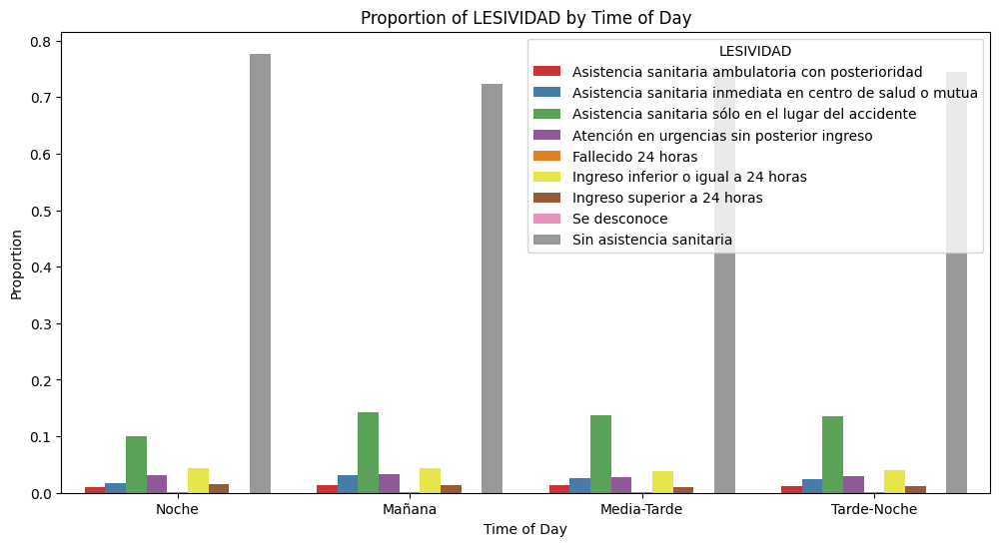

In [130]:
# Calculate the proportions of 'LESIVIDAD' within each time category
proportions = (accidentes.groupby(['TIME_OF_DAY', 'LESIVIDAD']).size() / accidentes.groupby('TIME_OF_DAY').size()).reset_index(name='Proportion')

# Plot the proportions using a bar plot
plt.figure(figsize=(12, 6))
sns.barplot(x='TIME_OF_DAY', y='Proportion', hue='LESIVIDAD', data=proportions, palette='Set1')
plt.title('Proportion of LESIVIDAD by Time of Day')
plt.xlabel('Time of Day')
plt.ylabel('Proportion')
plt.show()

C:\Users\paula\AppData\Local\Temp\ipykernel_27348\1310651944.py:19: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  proportions = (filtered_accidentes.groupby(['TIME_OF_DAY', 'LESIVIDAD_GROUP']).size() / filtered_accidentes.groupby('TIME_OF_DAY').size()).reset_index(name='Proportion')
C:\Users\paula\AppData\Local\Temp\ipykernel_27348\1310651944.py:19: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  proportions = (filtered_accidentes.groupby(['TIME_OF_DAY', 'LESIVIDAD_GROUP']).size() / filtered_accidentes.groupby('TIME_OF_DAY').size()).reset_index(name='Proportion')
c:\Users\paula\AppData\Local\Programs\Python\Pyt

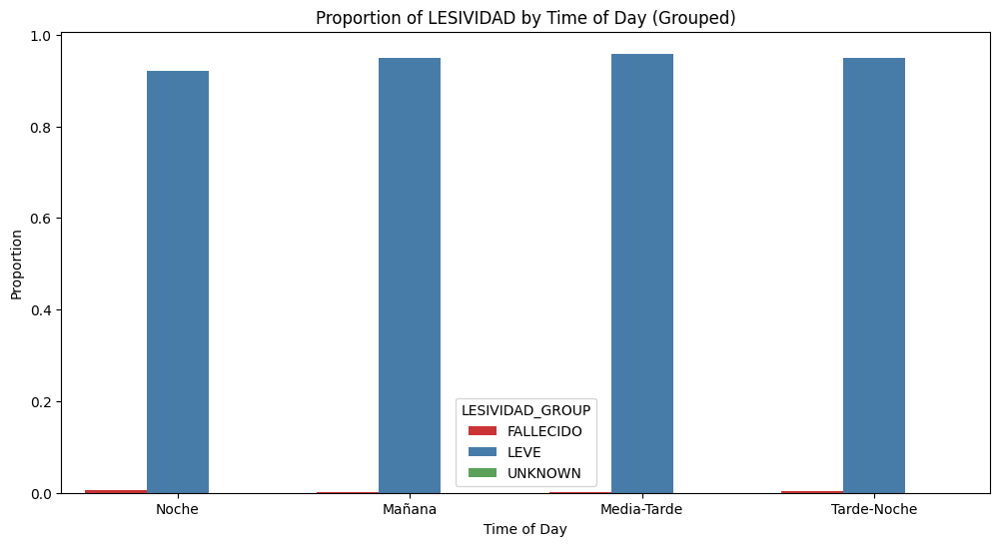

In [131]:
# Define a mapping between LESIVIDAD categories and color codes
lesividad_groups = {
    'Atención en urgencias sin posterior ingreso': 'LEVE',
    'Ingreso inferior o igual a 24 horas': 'LEVE',
    'Ingreso superior a 24 horas.':'GRAVE',
    'Fallecido 24 horas':'FALLECIDO',
    'Asistencia sanitaria ambulatoria con posterioridad':'LEVE',
    'Asistencia sanitaria inmediata en centro de salud o mutua':'LEVE',
    'Asistencia sanitaria sólo en el lugar del accidente':'LEVE',
    'Se desconoce': 'UNKNOWN'
}
# Map LESIVIDAD to LESIVIDAD_GROUP
accidentes['LESIVIDAD_GROUP'] = accidentes['LESIVIDAD'].map(lesividad_groups)

# Filter out rows with 'Sin asistencia sanitaria'
filtered_accidentes = accidentes[accidentes['LESIVIDAD'] != 'Sin asistencia sanitaria']

# Calculate the proportions of 'LESIVIDAD_GROUP' within each time category
proportions = (filtered_accidentes.groupby(['TIME_OF_DAY', 'LESIVIDAD_GROUP']).size() / filtered_accidentes.groupby('TIME_OF_DAY').size()).reset_index(name='Proportion')

# Plot the proportions using a bar plot
plt.figure(figsize=(12, 6))
sns.barplot(x='TIME_OF_DAY', y='Proportion', hue='LESIVIDAD_GROUP', data=proportions, palette='Set1')
plt.title('Proportion of LESIVIDAD by Time of Day (Grouped)')
plt.xlabel('Time of Day')
plt.ylabel('Proportion')
plt.show()

C:\Users\paula\AppData\Local\Temp\ipykernel_27348\3191386346.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  proportions = (filtered_accidentes.groupby(['TIME_OF_DAY', 'LESIVIDAD_GROUP']).size() / filtered_accidentes.groupby('TIME_OF_DAY').size()).reset_index(name='Proportion')
C:\Users\paula\AppData\Local\Temp\ipykernel_27348\3191386346.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  proportions = (filtered_accidentes.groupby(['TIME_OF_DAY', 'LESIVIDAD_GROUP']).size() / filtered_accidentes.groupby('TIME_OF_DAY').size()).reset_index(name='Proportion')
c:\Users\paula\AppData\Local\Programs\Python\Pytho

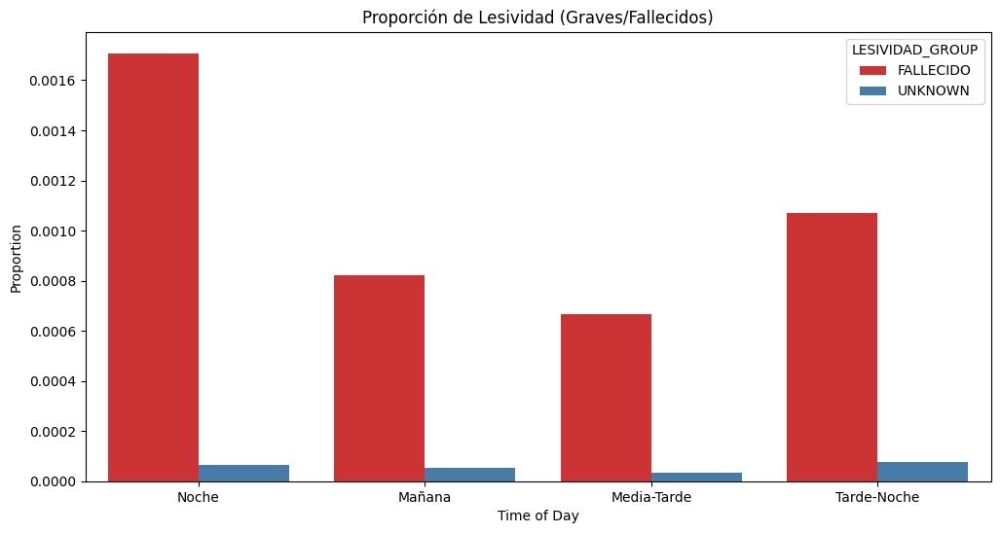

In [132]:
# Filter out rows with 'LEVE' in LESIVIDAD_GROUP
filtered_accidentes = accidentes[accidentes['LESIVIDAD_GROUP'] != 'LEVE']

# Calculate the proportions of 'LESIVIDAD_GROUP' within each time category
proportions = (filtered_accidentes.groupby(['TIME_OF_DAY', 'LESIVIDAD_GROUP']).size() / filtered_accidentes.groupby('TIME_OF_DAY').size()).reset_index(name='Proportion')

# Plot the proportions using a bar plot
plt.figure(figsize=(12, 6))
sns.barplot(x='TIME_OF_DAY', y='Proportion', hue='LESIVIDAD_GROUP', data=proportions, palette='Set1')
plt.title('Proporción de Lesividad (Graves/Fallecidos)')
plt.xlabel('Time of Day')
plt.ylabel('Proportion')
plt.show()

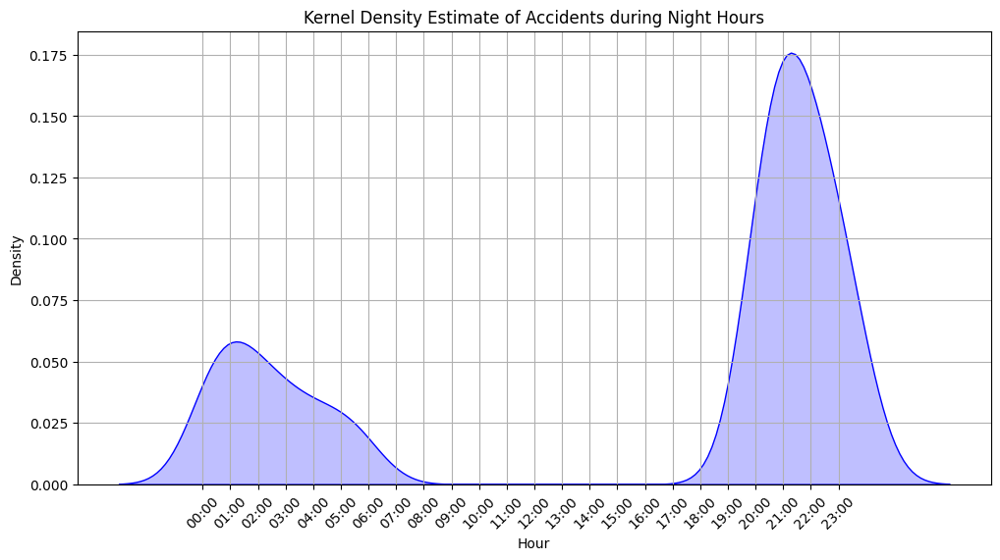

In [133]:
# Assuming 'HORA' is a datetime.time column
accidentes['HORA'] = accidentes['HORA'].apply(lambda x: x.hour + x.minute / 60)
# Filter the data for accidents during the night (assuming night hours are, for example, from 20:00 to 06:00)
night_accidents = accidentes[(accidentes['HORA'] >= 20) | (accidentes['HORA'] <= 6)]

# Plot the KDE line chart
plt.figure(figsize=(12, 6))
sns.kdeplot(night_accidents['HORA'], fill=True, color='blue')

# Set explicit x-axis ticks representing hours
plt.xticks(range(0, 24), [f'{hour:02d}:00' for hour in range(0, 24)])

plt.title('Kernel Density Estimate of Accidents during Night Hours')
plt.xlabel('Hour')
plt.ylabel('Density')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()


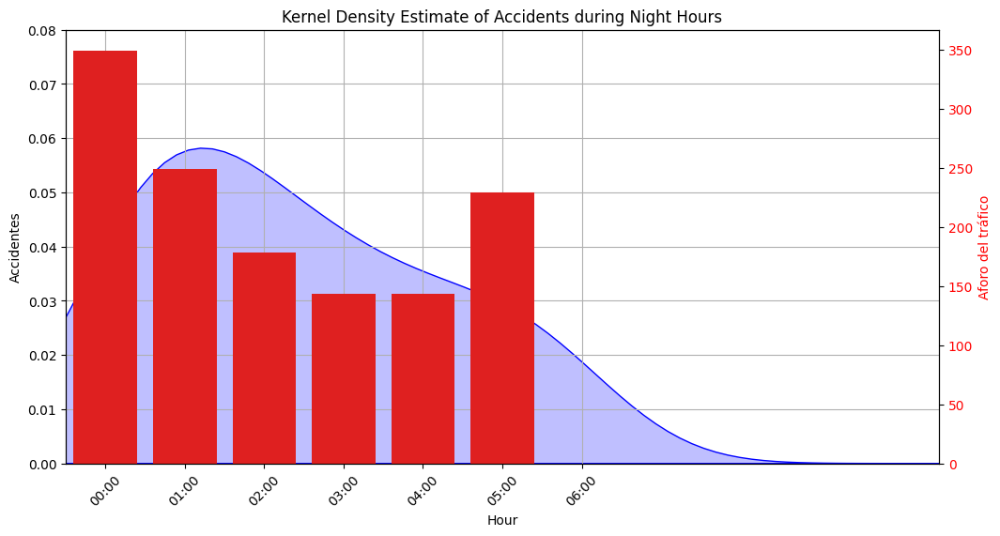

In [134]:
# Plot the KDE line chart
plt.figure(figsize=(12, 6))
sns.kdeplot(night_accidents['HORA'], fill=True, color='blue')

# Set explicit x-axis ticks representing hours
hour_ticks = list(range(20, 24)) + list(range(0, 7))
plt.xticks(hour_ticks, [f'{hour:02d}:00' for hour in hour_ticks])

# Set x-axis limits
plt.xlim(20, 6)
plt.title('Kernel Density Estimate of Accidents during Night Hours')
plt.xlabel('Hour')
plt.ylabel('Accidentes')
plt.xticks(rotation=45)
plt.grid(True)

# Set y-axis limits for the KDE plot to cover the entire range
plt.ylim(0, 0.08)  # Adjust the values based on your data

# Create a second y-axis for the average number of cars
ax2 = plt.twinx()
average_cars_per_hour = estaciones[['HOR1', 'HOR2', 'HOR3', 'HOR4', 'HOR5', 'HOR6']].mean(axis=0)
sns.barplot(x=average_cars_per_hour.index, y=average_cars_per_hour.values, color='red', ax=ax2)

# Set y-axis label for the second y-axis
ax2.set_ylabel('Aforo del tráfico', color='red')
ax2.tick_params(axis='y', labelcolor='red')

plt.show()